<a href="https://colab.research.google.com/github/luyuan320/project-201781208/blob/main/geog5990m_portfolio_assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GEOG5990M Portfolio assignment  (TEMPLATE)

Student ID number:



## Block One Submission
Using data introduced in the course create a visualisation showing the association between two variables. Using skills developed in the practical exercises take any steps required to clean or pre-process the data.  It is expected that you wills change the default appearance of the markers and include an appropriate title and axis labels. Further marks will be awarded for appropriate use of colour pallets, inclusion of additional categorical variables in the visualisation and other steps taken to ensure effective data visualisation.

Ensure all the code has detialed comments.

Write a brief paragraph in markdown (max. 300 words) detailing the visualisation choices made given the types of data you have chosen.

In [ ]:
# import required packages

import seaborn as sns
import matplotlib.pyplot as plt

# for data manipulation
import pandas as pd
import numpy as np

In [ ]:
# Data-preprocessing
# read in coffee data
coffee = pd.read_csv("https://github.com/FrancescaPontin/GEOG5990M/raw/refs/heads/main/data/week_16/coffee_data.csv")

# overview the information of coffee data
coffee.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24 entries, 0 to 23
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   coffee_name  24 non-null     object 
 1   coffee_type  24 non-null     object 
 2   coffee_shop  24 non-null     object 
 3   price        24 non-null     float64
 4   cake_deal    24 non-null     bool   
 5   rating       24 non-null     int64  
dtypes: bool(1), float64(1), int64(1), object(3)
memory usage: 1.1+ KB


In [ ]:
# overview of the coffee data frame and identify the number of non-null values in each columns
coffee.isnull().sum()

,0
coffee_name,0
coffee_type,0
coffee_shop,0
price,0
cake_deal,0
rating,0


In [ ]:
# Check for duplicate rows
coffee.duplicated().sum()

np.int64(0)

In [ ]:
# Display descriptive statistics for the coffee dataset
coffee.describe()

,price,rating
count,24.000000,24.00000
mean,3.129167,3.37500
std,3.640441,1.13492
min,0.800000,1.00000
25%,2.175000,3.00000
50%,2.500000,4.00000
75%,2.862500,4.00000
max,20.000000,5.00000


In [ ]:
# Check the 'price' column as the value 20 may be an outlier
print(coffee['price'])

0      2.40
1      2.60
2      2.50
3      2.00
4      2.50
5      2.70
6      2.75
7      3.00
8      2.90
9      1.80
10     3.00
11     2.50
12     3.00
13     2.70
14     2.20
15    20.00
16     1.00
17     2.85
18     1.90
19     3.10
20     2.10
21     2.40
22     2.40
23     0.80
Name: price, dtype: float64


In [ ]:
# "20" might have been recorded with a misplaced decimal point, making it 10 times larger than expected.
# Create a new column 'price_cleaning' to store the corrected coffee prices
coffee['price_cleaning'] = coffee['price']

# This correction adjusts prices that exceed the maximum reasonable value by dividing them by 10.
max_reasonable_price = 5.00
coffee.loc[coffee['price'] > max_reasonable_price,'price_cleaning'] = coffee['price']/10

# view column price_cleaning
print(coffee['price_cleaning'])

0     2.40
1     2.60
2     2.50
3     2.00
4     2.50
5     2.70
6     2.75
7     3.00
8     2.90
9     1.80
10    3.00
11    2.50
12    3.00
13    2.70
14    2.20
15    2.00
16    1.00
17    2.85
18    1.90
19    3.10
20    2.10
21    2.40
22    2.40
23    0.80
Name: price_cleaning, dtype: float64


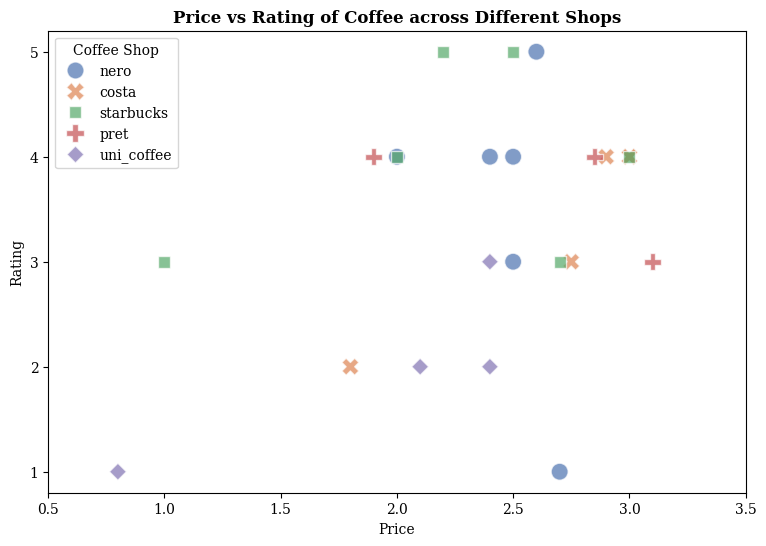

In [ ]:
# Data visualisation

# Create a new figure with a specific size: 9 inches wide and 6 inches tall
plt.figure(figsize=(9, 6))

# Generate a scatterplot to visualise the relationship between price and rating
# Different coffee shops are represented by distinct colours and marker styles
sns.scatterplot(x='price_cleaning', y='rating', hue='coffee_shop', style='coffee_shop', data=coffee,
                palette='deep', s=150, alpha=0.7)

# Add title to the plot and modify its appearance
plt.title("Price vs Rating of Coffee across Different Shops",  weight='bold',fontsize=12)

# Add axis label
plt.xlabel("Price")
plt.ylabel("Rating")

# Set font size for x and y axis tick labels
# Set y-axis ticks to specific values and limit x-axis range
plt.xticks(fontsize=10)
plt.yticks([1, 2, 3, 4, 5], fontsize=10)
plt.xlim(0.5, 3.5)

# Add legend
plt.legend(title="Coffee Shop")

# change font of plot
plt.rcParams['font.family']='serif'
plt.rcParams['font.serif']=['Times New Roman']+ plt.rcParams['font.serif']

# Display the plot
plt.show()



### Block One Submission
Edit this cell to include a brief paragraph (max. 300 words) detailing the visualisation choices made given the types of data you have chosen.


This block uses coffee data as the subject of analysis, selecting "Price" and "Rating" as the two variables to explore whether there is an association between product price and customer satisfaction. Since both variables are discrete, a scatter plot was chosen for visualization. Scatter plots are particularly suitable for displaying discrete data points between two variables, helping to identify potential distribution trends or patterns.(Bachthaler and Weiskopf, 2008)

Additionally, the categorical variable “Coffee Shop” was introduced to further investigate whether different brands show differences in ratings at the same price level. Cleveland (1984) (as cited in Kelleher and Wagener, 2011) suggests that in order to help readers distinguish between different visualization elements, visual attributes such as shape and color should be adjusted. Kelleher and Wagener (2011) also point out that in scatter plots, when points are opaque, overlapping data can become obscured, making density differences hard to recognize; by adjusting the transparency of points, differences in density become more visible. Since some data points in this case share the same price across different coffee shops and overlap on the graph, both color and shape were used to differentiate between coffee brands, while transparency was adjusted to improve readability and interpretation accuracy. A legend was added to allow readers to quickly identify which colors and shapes represent each coffee brand.

To enhance the readability and professionalism of the figure, the font was set to Times New Roman to give a more formal appearance. The font sizes of the title and axis labels were also adjusted to ensure clarity, and a bold title was added to clearly present the theme. These visual and functional refinements aim to make the chart not only visually appealing, but also effective in communicating the data insights behind the analysis.

Reference

Bachthaler, S. and Weiskopf, D. (2008). Continuous Scatterplots. *IEEE Transactions on Visualization and Computer Graphics*, 14(6), pp.1428–1435. doi:https://doi.org/10.1109/tvcg.2008.119.

Kelleher, C. and Wagener, T. (2011). Ten guidelines for effective data visualization in scientific publications. *Environmental Modelling & Software*, 26(6), pp.822–827. doi:https://doi.org/10.1016/j.envsoft.2010.12.006.








    

## Block Two Submission:

Using the course notebooks and lectures as a guide create a static visualisation showing the spatial distribution of a variable of your choice. The type of spatial visualisation chosen should be suitable for the data chosen and appropriate data cleaning and pre-processing steps undertaken. Using skills demonstrated in the python notebooks change the default appearance of the visualisation of choice. Include an appropriate title and legend labels. Further marks will be awarded for appropriate use of colour pallets and other customisations to aid interpretation and improve accessibility. Write a brief paragraph in markdown (max 300 words) detailing the visual design choices made.

In [ ]:
# import any further required packages
# Install required packages
!pip install contextily
!pip install geoplot
!pip install git+https://github.com/pmdscully/geo_northarrow.git
!pip install matplotlib-scalebar

# Import core libraries
import geopandas as gpd
import pyproj

# Plotting and visualisation
import contextily as ctx
import geoplot as gplt
import geoplot.crs as gcrs
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib import colormaps
from matplotlib.colors import to_hex

# North arrow and scalebar
from geo_northarrow import add_north_arrow
from matplotlib_scalebar.scalebar import ScaleBar


  Cloning https://github.com/pmdscully/geo_northarrow.git to /tmp/pip-req-build-8poh_o3x
  Running command git clone --filter=blob:none --quiet https://github.com/pmdscully/geo_northarrow.git /tmp/pip-req-build-8poh_o3x
  Resolved https://github.com/pmdscully/geo_northarrow.git to commit 963bdd271707a3bcaa47b2d83d92b88ae0b10950
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
# Data-preprocessing
# read data
bus_stops =gpd.read_file('https://github.com/FrancescaPontin/GEOG5990M/raw/refs/heads/main/data/week_6_7/West_Yorkshire_bus_stops.geojson')
leeds=gpd.read_file('https://github.com/FrancescaPontin/GEOG5990M/raw/refs/heads/main/data/week_6_7/leeds_travel_to_work_mode_distance.geojson')

In [ ]:
# overview information of data
bus_stops.info()
leeds.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 14255 entries, 0 to 14254
Data columns (total 13 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   STOPID     14255 non-null  int32   
 1   NAME       14255 non-null  object  
 2   TOWN       14255 non-null  object  
 3   0730_0930  14255 non-null  int32   
 4   1200_1400  14255 non-null  int32   
 5   1500_1830  14255 non-null  int32   
 6   2000_2100  14255 non-null  int32   
 7   x          14255 non-null  int32   
 8   y          14255 non-null  int32   
 9   z          14255 non-null  int32   
 10  PhotoF     14255 non-null  object  
 11  PhotoS     14255 non-null  object  
 12  geometry   14255 non-null  geometry
dtypes: geometry(1), int32(8), object(4)
memory usage: 1002.4+ KB
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 488 entries, 0 to 487
Data columns (total 27 columns):
 #   Column                                                                           Non

In [ ]:
# overview the first few rows
bus_stops.head()

,STOPID,NAME,TOWN,0730_0930,1200_1400,1500_1830,2000_2100,x,y,z,PhotoF,PhotoS,geometry
0,10001,Bodmin Road Helston Walk,Middleton,6,6,4,2,428983,428480,120,http://apps.westyorks-ca.gov.uk/stopinformatio...,http://apps.westyorks-ca.gov.uk/stopinformatio...,POINT Z (428983 428480 120)
1,10002,Bodmin Road Padstow Gardens,Middleton,6,6,4,2,429117,428112,120,http://apps.westyorks-ca.gov.uk/stopinformatio...,http://apps.westyorks-ca.gov.uk/stopinformatio...,POINT Z (429117 428112 120)
2,10003,Bodmin Road Padstow Place,Middleton,6,6,4,2,429287,427872,120,http://apps.westyorks-ca.gov.uk/stopinformatio...,http://apps.westyorks-ca.gov.uk/stopinformatio...,POINT Z (429287 427872 120)
3,10004,Bodmin Crescent Sissons Ter,Middleton,6,6,5,2,429447,427727,130,http://apps.westyorks-ca.gov.uk/stopinformatio...,http://apps.westyorks-ca.gov.uk/stopinformatio...,POINT Z (429447 427727 130)
4,10005,Ring Road Beeston Helston Croft,Middleton,9,10,6,5,429160,428503,130,http://apps.westyorks-ca.gov.uk/stopinformatio...,http://apps.westyorks-ca.gov.uk/stopinformatio...,POINT Z (429160 428503 130)


In [ ]:
leeds.head()

,FID,LSOA21CD,LSOA21NM,WD24NM,BNG_E,BNG_N,LONG,LAT,Total_distance_to_work,Less than 10km,...,"Bus, minibus or coach",Taxi,"Motorcycle, scooter or moped",Driving a car or van,Passenger in a car or van,Bicycle,On foot,Other method of travel to work,Not in employment or aged 15 years and under,geometry
0,10720,E01011264,Leeds 011A,Otley & Yeadon,420937,441836,-1.68306,53.87232,1284,200,...,25,2,1,312,23,5,45,6,703,"POLYGON ((421248.688 442315.812, 421284.072 44..."
1,10721,E01011265,Leeds 009A,Guiseley & Rawdon,418988,441951,-1.71269,53.87343,1953,240,...,17,4,2,335,23,11,72,10,998,"POLYGON ((418635 442559, 418637.555 442552.869..."
2,10722,E01011266,Leeds 008A,Guiseley & Rawdon,417489,442615,-1.73545,53.87945,2617,356,...,13,7,0,603,24,9,60,7,1174,"POLYGON ((417783.688 443382.312, 417788.688 44..."
3,10723,E01011267,Leeds 009B,Guiseley & Rawdon,419641,442025,-1.70276,53.87407,1701,269,...,15,8,3,373,21,8,87,3,937,"POLYGON ((419607.843 442388.568, 419612.752 44..."
4,10724,E01011268,Leeds 010A,Otley & Yeadon,420224,441935,-1.69390,53.87324,1401,278,...,35,8,1,316,36,10,99,2,757,"POLYGON ((420442.406 442436.687, 420443.313 44..."


In [ ]:
# overview of data frame and identify the number of non-null values in each columns
bus_stops.isnull().sum()

,0
STOPID,0
NAME,0
TOWN,0
0730_0930,0
1200_1400,0
1500_1830,0
2000_2100,0
x,0
y,0
z,0


In [ ]:
leeds.isnull().sum()

,0
FID,0
LSOA21CD,0
LSOA21NM,0
WD24NM,0
BNG_E,0
BNG_N,0
LONG,0
LAT,0
Total_distance_to_work,0
Less than 10km,0


In [ ]:
# identify the duplicate of data
bus_stops.duplicated().sum()

np.int64(0)

In [ ]:
leeds.duplicated().sum()

np.int64(0)

In [ ]:
# Check if the coordinate reference systems (CRS) of both datasets are consistent
print(leeds.crs, bus_stops.crs)

# Check if the geometry types of both datasets are correct
print(bus_stops.geom_type.unique(),leeds.geom_type.unique())

EPSG:27700 EPSG:27700
['Point'] ['Polygon']


In [ ]:
# overview statistic information of datasets
bus_stops.describe()

,STOPID,0730_0930,1200_1400,1500_1830,2000_2100,x,y,z
count,14255.000000,14255.000000,14255.000000,14255.000000,14255.000000,14255.000000,14255.000000,14255.000000
mean,18570.653174,3.500737,4.018309,2.949281,1.384427,421784.903683,427666.998387,120.595580
std,5118.272870,4.064011,4.476293,3.411516,1.681020,12167.190091,8994.989180,67.994917
min,10001.000000,0.000000,0.000000,0.000000,0.000000,389335.000000,403709.000000,10.000000
25%,14297.500000,1.000000,1.000000,1.000000,0.000000,412862.500000,421125.500000,70.000000
50%,18493.000000,2.000000,3.000000,2.000000,1.000000,420362.000000,427185.000000,110.000000
75%,22384.500000,5.000000,6.000000,4.000000,2.000000,430843.000000,434624.500000,160.000000
max,30341.000000,77.000000,83.000000,60.000000,24.000000,451663.000000,451242.000000,520.000000


In [ ]:
leeds.describe()

,FID,BNG_E,BNG_N,LONG,LAT,Total_distance_to_work,Less than 10km,10km to less than 30km,30km and over,Works mainly from home,...,Train,"Bus, minibus or coach",Taxi,"Motorcycle, scooter or moped",Driving a car or van,Passenger in a car or van,Bicycle,On foot,Other method of travel to work,Not in employment or aged 15 years and under
count,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,...,488.000000,488.00000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000,488.000000
mean,13058.920082,429745.625000,434948.334016,-1.549768,53.809959,1663.870902,297.844262,92.393443,20.198770,259.387295,...,8.081967,55.64959,11.006148,1.846311,320.174180,30.827869,10.575820,61.131148,7.331967,897.346311
std,6290.620828,5765.760679,4842.130100,0.087553,0.043536,328.096660,92.764834,48.459057,11.061683,124.859246,...,8.093235,37.86936,9.525819,1.810007,97.728138,13.549630,7.249612,43.753641,4.237852,264.177879
min,10720.000000,415777.000000,424017.000000,-1.761510,53.711780,1040.000000,37.000000,24.000000,3.000000,45.000000,...,0.000000,3.00000,0.000000,0.000000,85.000000,4.000000,0.000000,5.000000,0.000000,193.000000
25%,10841.750000,425662.500000,432060.750000,-1.611580,53.784145,1464.000000,243.000000,62.000000,13.000000,163.250000,...,3.000000,25.00000,4.000000,1.000000,265.000000,20.000000,5.000000,33.000000,4.000000,747.000000
50%,10963.500000,429497.000000,434871.000000,-1.553585,53.809380,1605.500000,296.000000,77.000000,18.000000,252.500000,...,5.500000,44.00000,8.000000,1.000000,315.500000,28.500000,9.000000,49.000000,7.000000,860.500000
75%,11085.250000,433151.750000,437635.000000,-1.498177,53.834153,1784.750000,357.000000,107.000000,24.000000,335.000000,...,10.000000,77.25000,16.000000,3.000000,371.000000,40.000000,13.000000,75.250000,10.000000,999.000000
max,33049.000000,444141.000000,449492.000000,-1.330510,53.940040,4345.000000,670.000000,427.000000,106.000000,1101.000000,...,49.000000,191.00000,63.000000,15.000000,858.000000,84.000000,50.000000,357.000000,28.000000,3316.000000


In [ ]:
# Check if the visualization of both datasets is correct using an interactive map
leeds.explore()

In [ ]:
bus_stops.explore()

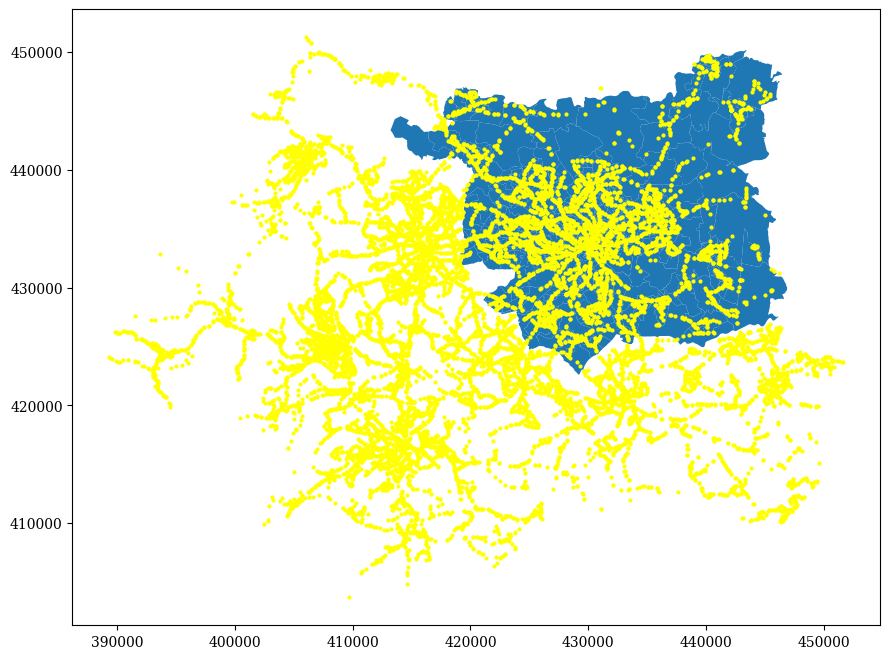

In [ ]:
# Check if the two layers overlap correctly by visualizing them together
# plot one subplot (1 map), with dimensions 16 X 8
f, ax = plt.subplots(1, figsize=(16, 8))

# define the basemap plot it on the sublot axis
base = leeds.plot(ax=ax)

# plot the bus stops on the basemap axis, colour the bus stops yellow
bus_stops.plot(ax=base,color='yellow', markersize=4)

# show the map
plt.show()

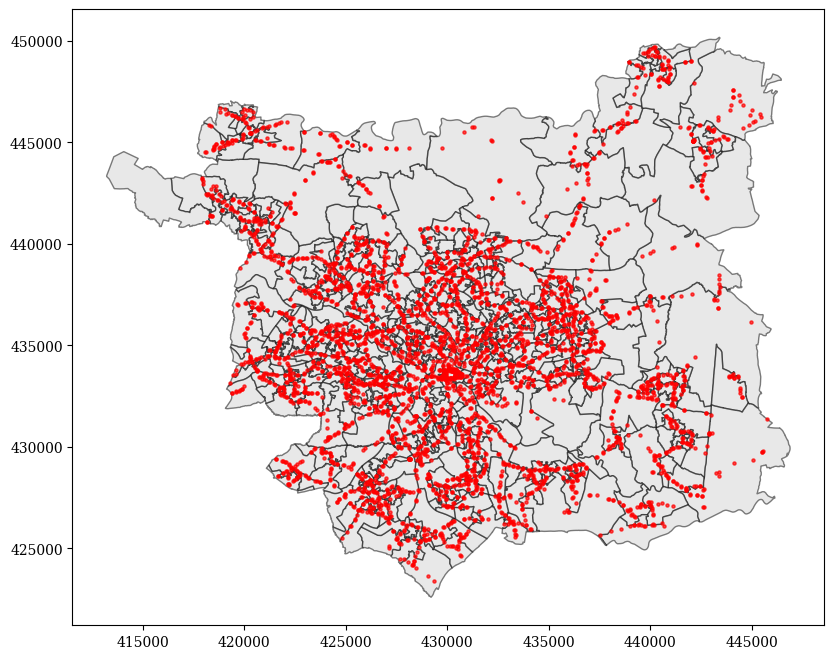

In [ ]:
# Data Visualisation

##### ChatGPT #####
# The following prompt was used in ChatGPT to clip West Yorkshire bus stops to Leeds area:
# "How to Clip Bus Stops to Only Leeds?  "
# The repsonse generated was used to help genrate the code below.

# Clip bus stops to Leeds boundary since the dataset covers a wider region
bus_stops_clipped = gpd.clip(bus_stops, leeds)

# Create a figure and axis with a size of 10x8 inches for plotting the map.
fig, ax = plt.subplots(figsize=(10, 8))

# Plot Leeds area to verify the clipped bus stops are within the boundary
leeds.plot(ax=ax, color="lightgray", edgecolor="black", alpha=0.5)
bus_stops_clipped.plot(ax=ax, color="red", markersize=5, alpha=0.7)

plt.show()


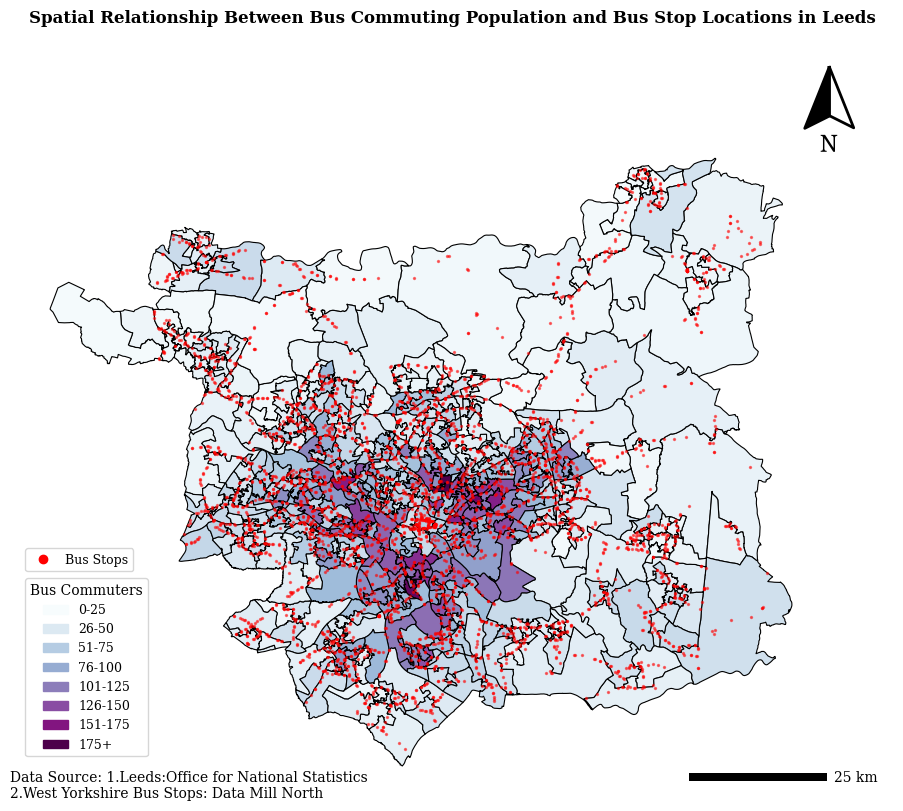

In [ ]:
# Create a figure and axis with a specific size (13 inches wide, 10 inches tall)
fig, ax = plt.subplots(figsize=(13, 10))

# Generating choropleth map and Leeds legend
leeds.plot(column ='Bus, minibus or coach', cmap="BuPu", linewidth=0.8,
           edgecolor="black", ax=ax)

##### ChatGPT #####
# The following prompt was used in ChatGPT to assist with manually generating the bus commuters legend:
# "Write Python code to manually create a categorical legend that matches the BuPu colormap bins in a choropleth map."
# The response generated was used to help generate the code below.

# Set the number of classes
n_bins = 8

# Extract 8 evenly spaced colours from the "BuPu" colormap
colors = [to_hex(colormaps["BuPu"](i / (n_bins - 1))) for i in range(n_bins)]

# Define corresponding category labels (must match the data binning)
labels = ['0-25', '26-50', '51-75', '76-100', '101-125', '126-150', '151-175', '175+']

# Create colour patches with associated labels
patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(n_bins)]

# Create and position the choropleth legend on the map
choropleth_legend = ax.legend(handles=patches, title='Bus Commuters', title_fontsize=10, fontsize=9, loc='lower left', bbox_to_anchor=(0.01, 0.05), frameon=True)

# Add the custom legend to the map
ax.add_artist(choropleth_legend)

# Add bus stops as red points
bus_stops_clipped.plot(ax=ax, color="red", markersize=2, alpha=0.5)

# The following prompt was used in ChatGPT to assist with adding the bus stops legend to the map:
# "Write some code in Python to add a bus stops legend."
# The response generated was used to help generate the code below.

# create a red point legend(bus stops)
bus_legend = mlines.Line2D([], [], color='red', marker='o', linestyle='None',
                           markersize=6, label='Bus Stops')

bus_legend_handle = ax.legend(handles=[bus_legend],loc='lower left', bbox_to_anchor=(0.01, 0.29), fontsize=9, title_fontsize=10,frameon=True)

# Add North Arrow
add_north_arrow(ax=ax, scale=.75, xlim_pos=1, ylim_pos=1, color='#000', text_scaler=2, text_yT=-1.25)

##### ChatGPT #####
# The following prompt was used in ChatGPT to assist with adding a scalebar to the map:
# "How to add a scalebar to a map in Python?"
# The response generated was used to help generate the code below.

# Add Plotting Scalebar
scalebar = ScaleBar(4, location="lower right", units="m",dimension="si-length", length_fraction=0.2, box_alpha=0.6,scale_loc="right",border_pad=1)
ax.add_artist(scalebar)

# Add titles and change appearance of title
plt.title("Spatial Relationship Between Bus Commuting Population and Bus Stop Locations in Leeds", fontsize=12,weight='bold')

# remove axis
ax.set_axis_off()

##### ChatGPT #####
# The following prompt was used in ChatGPT to assist with adding data source text:
# "How to write code to add data source text at the bottom left of the map?"
# The response generated was used to help generate the code below.

# Add data source text
ax.text(x=ax.get_xlim()[0]-0.02, y=ax.get_ylim()[0], s="Data Source: 1.Leeds:Office for National Statistics \n2.West Yorkshire Bus Stops: Data Mill North",
    fontsize=10,  color="black",  ha="left",  va="bottom",  bbox=dict(facecolor="white", alpha=0.8, edgecolor="none"))

plt.show()

### Block Two Submission
Edit this celll to include a brief paragraph (max. 300 words) detailing the spatial data visualisation choices made given the types of data you have chosen.

This block selected bus stops data from West Yorkshire and 2021 census data about travel to work distance and transport mode of Leeds. The variable chosen for visualisation is the number of people commuting by “Bus, minibus or coach.” Stewart and Kennelly (2010) pointed out that choropleth maps are commonly used to show statistical variation between enumeration units. Therefore, the choropleth map was selected as the primary visualisation method to clearly present the spatial distribution of bus commuters across different areas of Leeds. The variable was divided into eight intervals ranging from “0–25” to “175+” to better represent differences in values.

Harrower and Brewer (2003) (as cited in Kelleher and Wagener, 2011) suggested that continuous quantitative data should be visualised using a light-to-dark colour gradient to reflect an increasing trend from low to high values. As such, the “BuPu” colour scheme was applied in this map, and a custom legend was manually added to clearly indicate the number range represented by each colour.

To further explore the spatial relationship between the distribution of bus stops and the number of bus transport commuters, a point layer of bus stops was overlaid on the choropleth map, marked in red. Since the original dataset covered the entire West Yorkshire area, the Leeds administrative boundary was used to clip the data, retaining only bus stops within Leeds in order to improve accuracy and relevance.

In addition, a customised north arrow, scale bar, title, and legend were added to enhance the map’s professionalism and readability. The font style and element positions were adjusted accordingly. The data sources were also clearly labelled to ensure completeness and traceability of the map content.

Reference

Kelleher, C. and Wagener, T. (2011). Ten guidelines for effective data visualization in scientific publications. *Environmental Modelling & Software*, 26(6), pp.822–827. doi:https://doi.org/10.1016/j.envsoft.2010.12.006.

Stewart, J. and Kennelly, P.J. (2010). Illuminated Choropleth Maps. *Annals of the Association of American Geographers*, 100(3), pp.513–534. doi:https://doi.org/10.1080/00045608.2010.485449.







## Acknowledgements

The use of Gen AI must be acknowledged in an ‘Acknowledgements’ section of any piece of academic work where it has been used as a functional tool to assist in the process of creating academic work.
If it is suspected that you have used a Gen AI tool to produce part of your work, but you have not acknowledged this use, this could be investigated under the Academic Misconduct procedure.
The minimum requirement to include in acknowledgement:
- Name and version of the generative AI system used eg ChatGPT-4.0
- Publisher (company that made the AI system) eg OpenAI
- URL of the AI system
- Brief description (single sentence) of context in which the tool was used.

For example: “I acknowledge the use of ChatGPT-3.5 (Open AI, https://chat.openai.com/) to support development of code to generate legend headings and support formatting of figures”
In the code state:  Prompt: write some python code using the Geopandas package to add a legend title for a colour bar”

For example: “I acknowledge the use of Co-pilot (Microsoft https://chat.openai.com/ Accessed 2025-4-03) to support debugging errors as identified in the code, Prompt: Help debug this error {ERROR MESSAGE} genrated while using the geopandas package”

I acknowledge the use of ChatGPT-4o (OpenAI, https://chat.openai.com/) to assist with generating code for clipping bus stop data to the Leeds boundary, adding a categorical legend, a scalebar, and data source text in the spatial visualisation map.
In the code state: Prompt: 1.“How to Clip Bus Stops to Only Leeds?”2."Write Python code to manually create a categorical legend that matches the BuPu colormap bins in a choropleth map."3."Write some code in Python to add a bus stops legend." 4."How to add a scalebar to a map in Python?" 5."How to write code to add data source text at the bottom left of the map?"